In [1]:
import numpy as np
import cv2
import glob
import matplotlib as mpl
import matplotlib.pyplot as plt
from PIL import Image
import os
import scipy
import random
from sklearn.neighbors import KDTree

# Load data

In [2]:
idx = 1

all_images = glob.glob(f'data/*?1.*')
selectable_images = [img.split("/")[1].split(".")[0][0:-1] for img in all_images]


a_img_path, b_img_path = glob.glob(f'data/{selectable_images[idx]}*')

#a_img_color = cv2.imread(a_img_path)
#b_img_color = cv2.imread(b_img_path)

a_img_color = cv2.imread("custom_data/09/5.jpeg")
b_img_color = cv2.imread("custom_data/09/4.jpeg")

# res_a, cv2.imread("custom_data/07/3.jpeg")

a_img = cv2.cvtColor(a_img_color, cv2.COLOR_BGR2GRAY)
b_img = cv2.cvtColor(b_img_color, cv2.COLOR_BGR2GRAY)

a_img_color = cv2.cvtColor(a_img_color, cv2.COLOR_BGR2RGB)
b_img_color = cv2.cvtColor(b_img_color, cv2.COLOR_BGR2RGB)

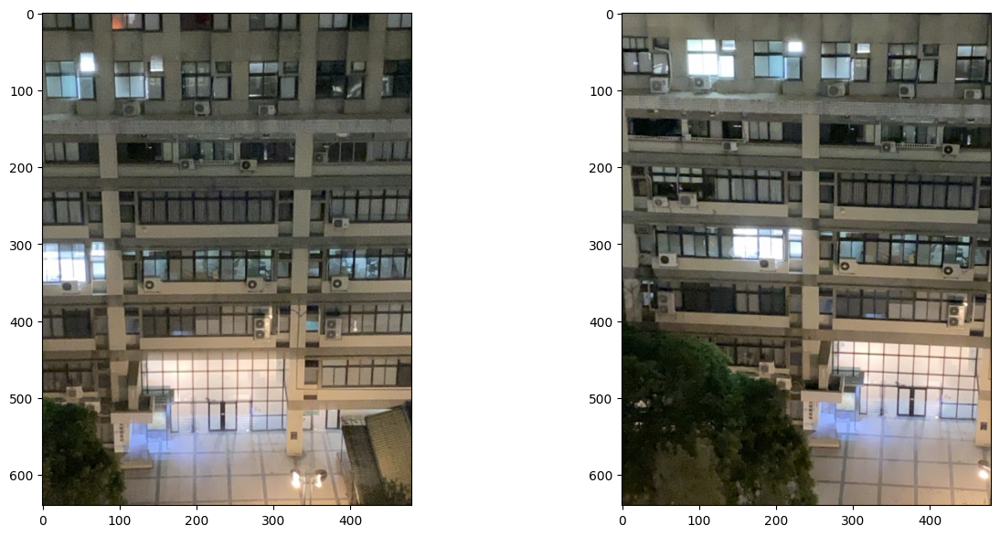

In [3]:
fig, axs = plt.subplots(1,2, figsize=(15,7))
plt.gray()
axs[0].imshow(a_img_color)
axs[1].imshow(b_img_color)

# Detect SIFT keypoints

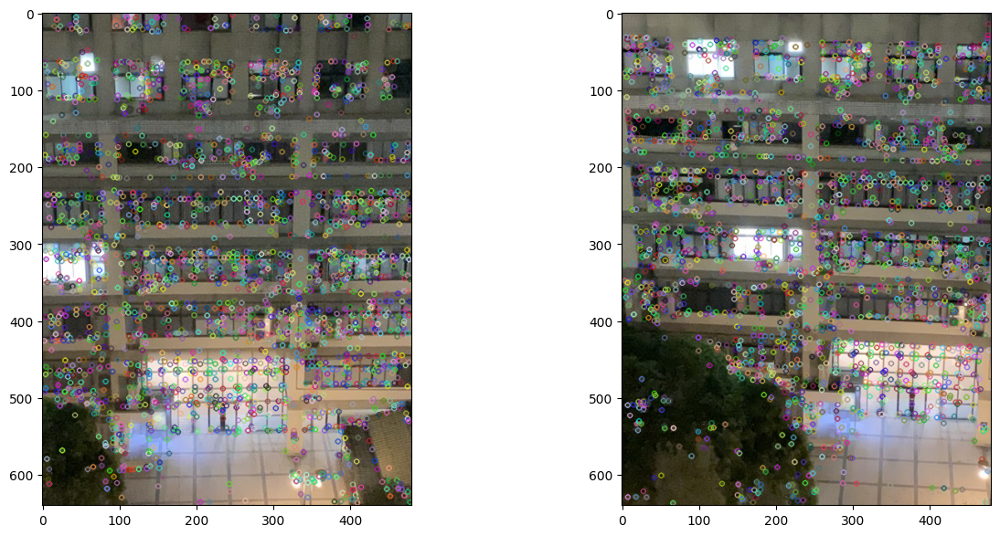

In [4]:
sift = cv2.SIFT_create()
a_kp = sift.detect(a_img,None)
b_kp = sift.detect(b_img,None)

fig, axs = plt.subplots(1,2, figsize=(15,7))
plt.gray()
axs[0].imshow(cv2.drawKeypoints(a_img_color,a_kp,a_img))
axs[1].imshow(cv2.drawKeypoints(b_img_color,b_kp,b_img))

In [5]:
a_keypoints, a_descriptors = sift.compute(a_img,a_kp)
b_keypoints, b_descriptors = sift.compute(b_img,b_kp)

In [6]:
def distance_fn(a,b):
    return np.linalg.norm(a - b)

def match_keypoints(a_keypoints, a_descriptors, b_keypoints, b_descriptors, treshold = 50):
    matches = []
    b_matched = set()
    
    a_new_keypoints = []
    b_new_keypoints = []
    
    for a_index, a_keypoint, a_descriptor in zip(range(len(a_keypoints)),a_keypoints, a_descriptors):
        min_index = -1
        min_dist = 1e20
        min_keypoint = None
        
        for b_index, b_keypoint, b_descriptor in zip(range(len(b_keypoints)),b_keypoints, b_descriptors):
            dist = distance_fn(a_descriptor, b_descriptor)
    
            if min_dist > dist and b_index not in b_matched:
                min_dist = dist
                min_index = b_index
                min_keypoint = b_keypoint
        
        if min_dist < treshold:
            matches.append((a_index, min_index))
            b_matched.add(b_index)
    
            a_new_keypoints.append(a_keypoint)
            b_new_keypoints.append(min_keypoint)
    return a_new_keypoints, b_new_keypoints, matches

#a_new_keypoints, b_new_keypoints, matches = match_keypoints(a_keypoints,a_descriptors, b_keypoints,b_descriptors, treshold = 60)
#print(f"found {len(matches)} matches (#a = {len(a_keypoints)} , #b = {len(b_keypoints)})")


In [7]:
def match_keypoints_flann(a_keypoints, a_descriptors, b_keypoints, b_descriptors, threshold=100):
    # Convert descriptors to correct format (float32)
    a_descriptors = np.array(a_descriptors, dtype=np.float32)
    b_descriptors = np.array(b_descriptors, dtype=np.float32)
    
    # FLANN parameters
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)   # Higher checks = more accurate but slower
    
    # Create FLANN matcher
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    
    # Find k=2 nearest matches
    matches = flann.knnMatch(a_descriptors, b_descriptors, k=2)
    
    # Apply Lowe's ratio test and threshold
    good_matches = []
    a_new_keypoints = []
    b_new_keypoints = []
    b_matched = set()
    
    for m, n in matches:
        # m.distance is the distance to the nearest neighbor
        # n.distance is the distance to the second nearest neighbor
        if m.distance < threshold and m.distance < 0.8 * n.distance:
            if m.trainIdx not in b_matched:  # Ensure uniqueness
                good_matches.append((m.queryIdx, m.trainIdx))
                b_matched.add(m.trainIdx)
                a_new_keypoints.append(a_keypoints[m.queryIdx])
                b_new_keypoints.append(b_keypoints[m.trainIdx])
    
    return a_new_keypoints, b_new_keypoints, good_matches

# Usage:
a_new_keypoints, b_new_keypoints, matches = match_keypoints_flann(
    a_keypoints, a_descriptors, 
    b_keypoints, b_descriptors, 
    threshold = 860
)
print(f"found {len(matches)} matches (#a = {len(a_keypoints)} , #b = {len(b_keypoints)})")

found 676 matches (#a = 2959 , #b = 2645)


In [8]:
colors = [
    '#1f77b4',  # muted blue
    '#ff7f0e',  # safety orange
    '#2ca02c',  # cooked asparagus green
    '#d62728',  # brick red
    '#9467bd',  # muted purple
    '#8c564b',  # chestnut brown
    '#e377c2',  # raspberry yogurt pink
    '#7f7f7f',  # middle gray
    '#bcbd22',  # curry yellow-green
    '#17becf'   # blue-teal
]

def get_keypoint_coord(kp):
        if isinstance(kp, tuple) or isinstance(kp, np.ndarray):
            return kp[0], kp[1]
        # Assuming cv2.KeyPoint format
        return kp.pt[0], kp.pt[1]

def draw_matches_custom(img1, img2, kp1, kp2, matches, 
                       line_color='r', point_color='r', 
                       line_width=0.5, point_size=5,
                       max_matches=None):
    # Create a figure with two subplots side by side
    fig = plt.figure(figsize=(10, 5))
    
    # Function to handle different keypoint formats
    
    
    # Calculate the height ratio for proper alignment
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Create two subplots with proper spacing
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    
    # Display images
    ax1.imshow(img1)
    ax2.imshow(img2)
    
    # Turn off axes
    ax1.axis('off')
    ax2.axis('off')
    
    # Limit the number of matches if specified
    if max_matches is not None:
        matches = matches[:max_matches]
    
    # Draw matches
    for idx1, idx2 in matches:
        color = random.choice(colors)
        
        
        # Get coordinates
        x1, y1 = get_keypoint_coord(kp1[idx1])
        x2, y2 = get_keypoint_coord(kp2[idx2])
        
        # Draw keypoints
        ax1.plot(x1, y1, 'o', color=color, markersize=point_size, markerfacecolor='none' )
        ax2.plot(x2, y2, 'o', color=color, markersize=point_size, markerfacecolor='none' )
        
        con = mpl.patches.ConnectionPatch(
            xyA=(x1, y1), xyB=(x2, y2),
            coordsA="data", coordsB="data",
            axesA=ax1, axesB=ax2,
            color=color, linewidth=line_width
        )
        fig.add_artist(con)
    
    # Add title
    plt.suptitle(f'Custom Matching Visualization ({len(matches)} matches)', fontsize=16)
    
    # Adjust layout
    plt.tight_layout()
    
    #return fig


In [9]:
def get_img_matches(a_img, b_img):
    sift = cv2.SIFT_create()
    print('searching for SIFT keypoints')
    a_kp = sift.detect(a_img,None)
    b_kp = sift.detect(b_img,None)
    
    a_keypoints, a_descriptors = sift.compute(a_img,a_kp)
    b_keypoints, b_descriptors = sift.compute(b_img,b_kp)

    print('matching keypoints')
    a_new_keypoints, b_new_keypoints, matches = match_keypoints_flann(a_keypoints, a_descriptors, b_keypoints, b_descriptors)

    A_keypoints = np.vstack(
        [np.array(get_keypoint_coord(kp)) for kp in a_new_keypoints]
    )

    B_keypoints = np.vstack(
        [np.array(get_keypoint_coord(kp)) for kp in b_new_keypoints]
    )
    
    return A_keypoints, B_keypoints



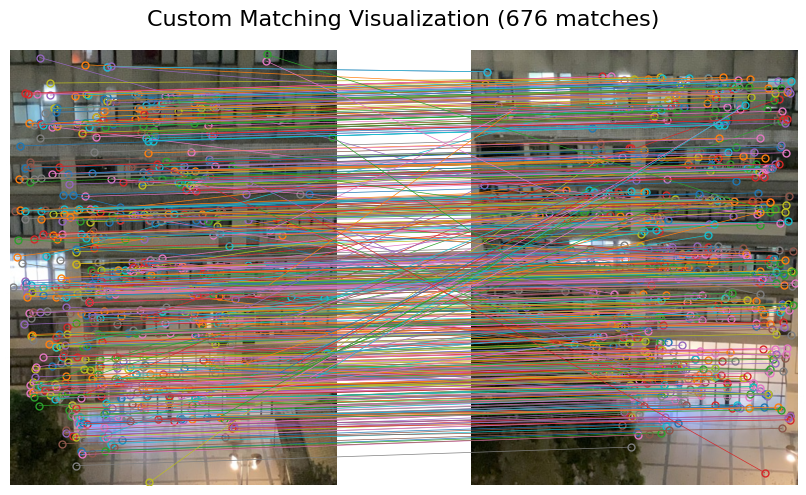

In [10]:
draw_matches_custom(a_img_color, b_img_color, a_keypoints, b_keypoints, matches)

In [11]:
A_keypoints = np.vstack(
        [np.array(get_keypoint_coord(kp)) for kp in a_new_keypoints]
    )

B_keypoints = np.vstack(
    [np.array(get_keypoint_coord(kp)) for kp in b_new_keypoints]
)

print(A_keypoints.shape)
print(B_keypoints.shape)

(676, 2)
(676, 2)


# Finding homography via RANSAC ?


In [12]:
def homography_distances(H,X,Y):
    X_homo = np.hstack([
        X, 
        np.ones((X.shape[0],1))
    ])
    
    Y_homo = np.hstack([
        Y, 
        np.ones((Y.shape[0],1))
    ])

    K = np.dot(H,Y_homo.T).T
    K[:,0] /= K[:,2]
    K[:,1] /= K[:,2]
    K[:,2] /= K[:,2]
    
    return np.linalg.norm(
        K - X_homo,
        axis=1
    )

def find_homography(X,Y):
    assert X.shape == Y.shape
    assert X.shape[0] == Y.shape[0]
    assert X.shape[1] == Y.shape[1] == 2
    
    a_list = []
    
    for index in range(X.shape[0]):
        i,j = Y[index,:]
        u,v = X[index,:]
        
        a_list.append(np.array([
            i, j, 1,
            0, 0, 0,
            -u*i,-u*j,-u,
        ]))
        a_list.append(np.array([
                0, 0, 0,    
                i, j, 1,
                -v*i,-v*j,-v,
        ]))
    A = np.vstack(a_list)

    _,_,D = np.linalg.svd(A)
    H = D[-1,:].reshape(3,3)
    H /=  H[-1,-1] 

    return H

H = find_homography(A_keypoints, B_keypoints)
print(np.average(homography_distances(H, A_keypoints, B_keypoints)))

369.8272525535658


In [13]:
def plot_homography_result(H,X,Y, img):
    fig = plt.figure(figsize=(10, 15))
    plt.imshow(img)

    for i in range(X.shape[0]):
        color = random.choice(colors)
        x = np.dot(H, np.array([X[i,0], X[i,1], 1]))
        x /= x[-1]
        
        y = np.array([Y[i,0], Y[i,1], 1])
        

        plt.plot(x[0], x[1], 'o', color=color, markersize=4, markerfacecolor='none')
        plt.plot(y[0], y[1], 'o', color=color, markersize=4)
        plt.plot((x[0], y[0]), (x[1], y[1]), color=color, linewidth=0.5)

In [14]:
def ransac_find_homography_iteration(X,Y, N = 10, treshold = 1):
    assert X.shape == Y.shape
    
    num_data = X.shape[0]
    sample_indexes = np.random.randint(num_data, size = N)
    X_sample = X[sample_indexes, :]
    Y_sample = Y[sample_indexes, :]

    H = find_homography(X_sample, Y_sample)
    distances = homography_distances(H, X, Y)
    ratio = np.average(distances < treshold)
    
    return H, ratio

def ransac_find_homograpy(
    X,Y,
    num_iterations = 5,
    N = 10, 
    treshold = 1,
    ):
    assert X.shape == Y.shape
    assert X.shape[1] == Y.shape[1] == 2

    best_ratio = 0
    best_H = np.zeros((3,3))
    
    for i in range(num_iterations):
        H, ratio = ransac_find_homography_iteration(X,Y, N, treshold)
        #print(i,ratio)

        if ratio > best_ratio:
            best_ratio = ratio
            best_H = H
        
    return best_H, best_ratio

ratio of points in treshold 0.7958579881656804


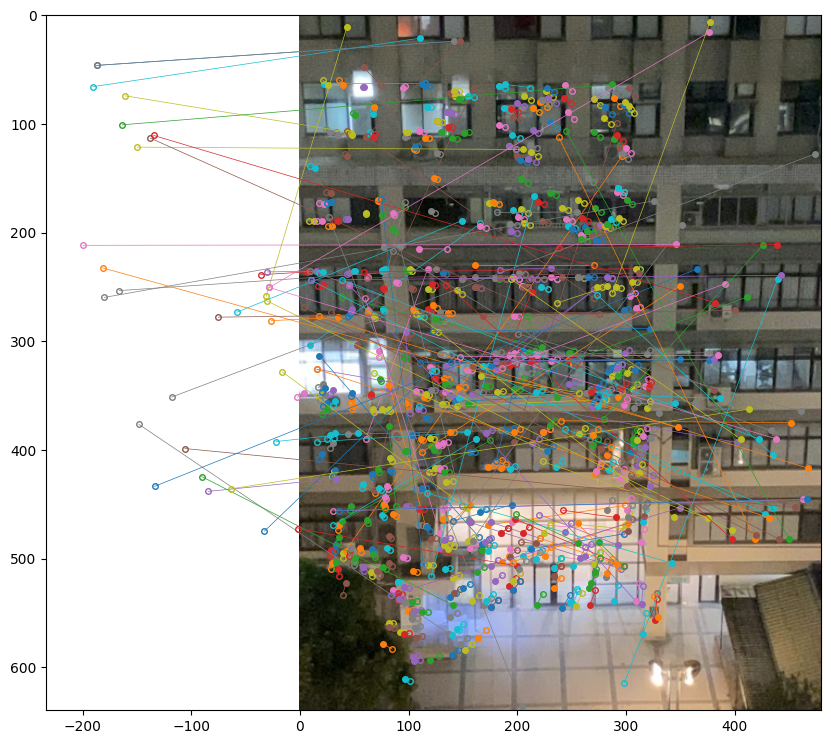

In [15]:
#ransac_find_homography_iteration(A_keypoints, B_keypoints, N = 5, treshold = 2)

H, ratio = ransac_find_homograpy(A_keypoints, B_keypoints, 
                      treshold = 30,
                      num_iterations = 500,
                      N = 10
                     )

print('ratio of points in treshold',ratio)

plot_homography_result(H,B_keypoints,A_keypoints, a_img_color)

# Image warping

In [16]:
def draw_polygon(points, color='red', fill = False, dashed = False):
   import matplotlib.pyplot as plt
   
   # Extract x and y coordinates (ignoring the ones column)
   x_coords = points[:, 0]  
   y_coords = points[:, 1]
   
   # Add first point at end to close the polygon
   x_coords = np.append(x_coords, x_coords[0])
   y_coords = np.append(y_coords, y_coords[0])
   
   # Plot the polygon
   plt.plot(x_coords, y_coords,'--' if dashed else '-', color=color)
   fill and plt.fill(x_coords, y_coords, alpha=0.3, color=color)
   plt.axis('equal')  # Equal aspect ratio
   plt.grid(True)

In [17]:
def get_border_and_bb(B,H):
    H_inv = np.linalg.inv(H)

    B_borders = np.array([
        [0,0, 1],
        [0, B.shape[0], 1],
        [B.shape[1],B.shape[0],1],
        [B.shape[1], 0,1]
    ])

    B_border_in_A = np.dot(H, B_borders.T).T
    
    B_border_in_A[:,0] /= B_border_in_A[:,2]
    B_border_in_A[:,1] /= B_border_in_A[:,2]
    B_border_in_A[:,2] /= B_border_in_A[:,2]
    

    min_x = np.floor(np.min(B_border_in_A[:,0]))
    max_x = np.ceil(np.max(B_border_in_A[:,0]))
    min_y = np.floor(np.min(B_border_in_A[:,1]))
    max_y= np.ceil(np.max(B_border_in_A[:,1]))

    B_border_in_A_bb = np.array([
        [min_x, min_y, 1],
        [max_x, min_y, 1],
        [max_x, max_y, 1],
        [min_x, max_y, 1]
    ])

    

    return B_border_in_A, B_border_in_A_bb

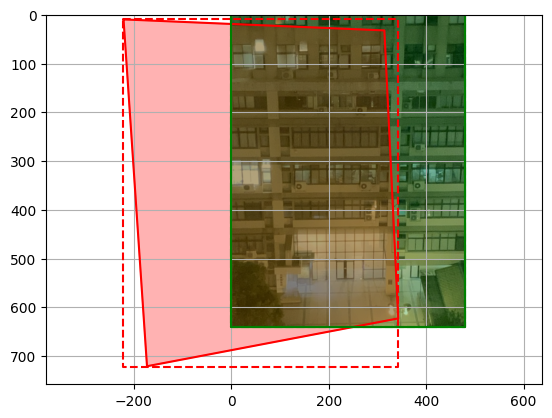

In [18]:
b_in_a_border, b_in_a_bb = get_border_and_bb(b_img, H)
a_in_a_border, a_in_a_bb = get_border_and_bb(a_img, np.eye(3))

plt.imshow(a_img_color)
draw_polygon(b_in_a_border, color='red', fill = True)
draw_polygon(b_in_a_bb, color='red', dashed = True)

draw_polygon(a_in_a_border, color='green', fill=True)
draw_polygon(a_in_a_bb, color='green', dashed = True)

In [19]:
def bilinear_map(I,p):
    x,y,_ = p
    if x < 2 or \
       y < 2 or\
       x + 1 >= I.shape[1] or\
       y + 1 >= I.shape[0]:
        return None

    # if x < 5 or \
    #    y < 5 or\
    #    x + 6 >= I.shape[1] or\
    #    y + 6 >= I.shape[0]:
    #     return np.array([0,255,128],dtype=np.float32)

    dh = x - np.floor(x)
    dv = y - np.floor(y)

    l = np.floor(x).astype(int)
    r = l + 1

    t = np.floor(y).astype(int)
    b = t + 1

    tp = (1 - dh) * I[t,l, :] + dh * I[t,r, :]
    bp = (1 - dh) * I[b,l, :] + dh * I[b,r, :]

    p = (1 - dv) * tp + dv * bp
    
    return p

704 724
[array([[  0.,   9.,   1.],
       [565.,   9.,   1.],
       [565., 722.,   1.],
       [  0., 722.,   1.]]), array([[222.,   0.,   1.],
       [702.,   0.,   1.],
       [702., 640.,   1.],
       [222., 640.,   1.]])]


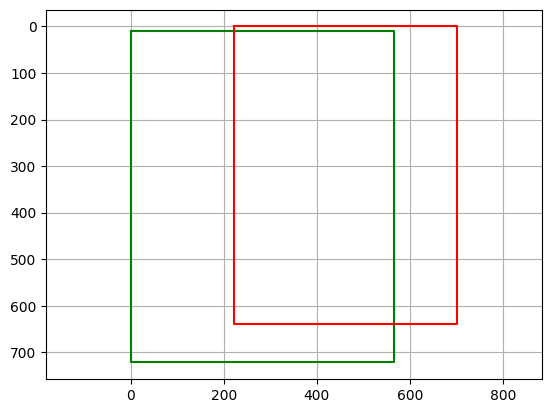

In [20]:
def determine_dest_img_dimensions_and_transform(bb_list, scale = 1):
    bb_mat = np.vstack(bb_list)

    x_min = np.floor(np.min(bb_mat[:, 0])).astype(int)
    x_max = np.ceil(np.max(bb_mat[:, 0])).astype(int)

    y_min = np.floor(np.min(bb_mat[:, 1])).astype(int)
    y_max = np.ceil(np.max(bb_mat[:, 1])).astype(int)
    
    translation = np.array([-x_min, -y_min])

    width = int((x_max - x_min + 1) * scale)
    height = int((y_max - y_min + 1) * scale)

    translation_mat = np.array([
        [1, 0, -np.min(bb_mat[:, 0])],
        [0, 1, -np.min(bb_mat[:, 1])],
        [0, 0, 1]
    ])

    scale_mat = np.array([
        [scale,0,0],
        [0,scale,0],
        [0,0,1]
    ])


    T = np.matmul(scale_mat, translation_mat)

    transformed_bbs = [np.dot(T, bb.T).T for bb in bb_list]
    #print(transformed_bbs)

    return width, height, T, transformed_bbs

width_d, height_d, T, bb_list_d = determine_dest_img_dimensions_and_transform([b_in_a_bb, a_in_a_bb])
b_bb_d, a_bb_d = bb_list_d
print(width_d + 1, height_d + 1)
print(bb_list_d)

plt.gca().invert_yaxis()
draw_polygon(b_bb_d, color='green')
draw_polygon(a_bb_d, color='red')

In [21]:
def warp_onto(dest, source, bb, H):
    H_inv = np.linalg.inv(H)
    
    for x_o in range(np.min(bb[:,0]).astype(int), np.max(bb[:,0]).astype(int)):
        for y_o in range(np.min(bb[:,1]).astype(int), np.max(bb[:,1]).astype(int)):
            try:
                p_o = np.array([x_o,y_o, 1])
                p_s = np.dot(H_inv, p_o)
                p_s /= p_s[-1]
                
                pix = bilinear_map(source,p_s)
                
                if pix is not None:
                    dest[y_o, x_o, :] = pix.astype(np.uint8)
            except:
                pass
    return dest

In [22]:
def warp_fast(dest, source, bb, H):
    x_min, x_max, y_min, y_max = np.min(bb[:,0]), np.max(bb[:,0]), np.min(bb[:,1]), np.max(bb[:,1])

    H_inv = np.linalg.inv(H)
    
    x = np.linspace(
        x_min, x_max,
        num=int(x_max - x_min) + 1,
    )
    y = np.linspace(
        y_min, y_max,
        num=int(y_max - y_min) + 1, 
    )    
    X,Y = np.meshgrid(x,y)

    O = np.stack([X,Y, np.ones_like(X)], axis=-1).reshape(-1,3).astype(int)
    
    D = (H_inv @ O.T).T
    
    D[:,0] /= D[:,2]
    D[:,1] /= D[:,2]
    D[:,2] /= D[:,2]

    # bilinear map thingie
    mask = (D[:,0] >= 0) & \
        (D[:,1] >= 0) & \
        (D[:, 0] <= source.shape[1] - 2) & \
        (D[:, 1] <= source.shape[0] - 2)

    D_f = D[mask]
    dh = D_f[:,0] - np.floor(D_f[:,0])
    dv = D_f[:,1] - np.floor(D_f[:,1])

    l = np.floor(D_f[:,0]).astype(int)
    r = l + 1
    
    t = np.floor(D_f[:,1]).astype(int)
    b = t + 1

    tp = (1 - dh[:,np.newaxis]) * source[t,l, :] + dh[:,np.newaxis] * source[t,r, :]
    bp = (1 - dh[:,np.newaxis]) * source[b,l, :] + dh[:,np.newaxis] * source[b,r, :]

    p_round = source[t,l, :]
    p = p_round
    
    p = (1 - dv[:,np.newaxis]) * tp + dv[:,np.newaxis] * bp
    p = p.astype(np.uint8)

    dest[O[mask][:,1],O[mask][:,0], :] = p
    
    
    return dest

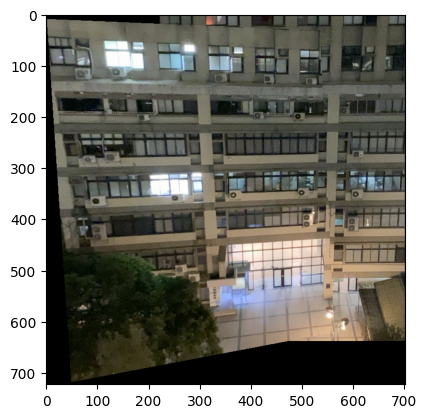

In [23]:
destination = np.zeros((height_d, width_d, 3), dtype=np.uint8)

warp_fast(destination, a_img_color ,a_bb_d, T)
destination = warp_fast(destination, b_img_color ,b_bb_d, np.matmul(T,H))
plt.imshow(destination)

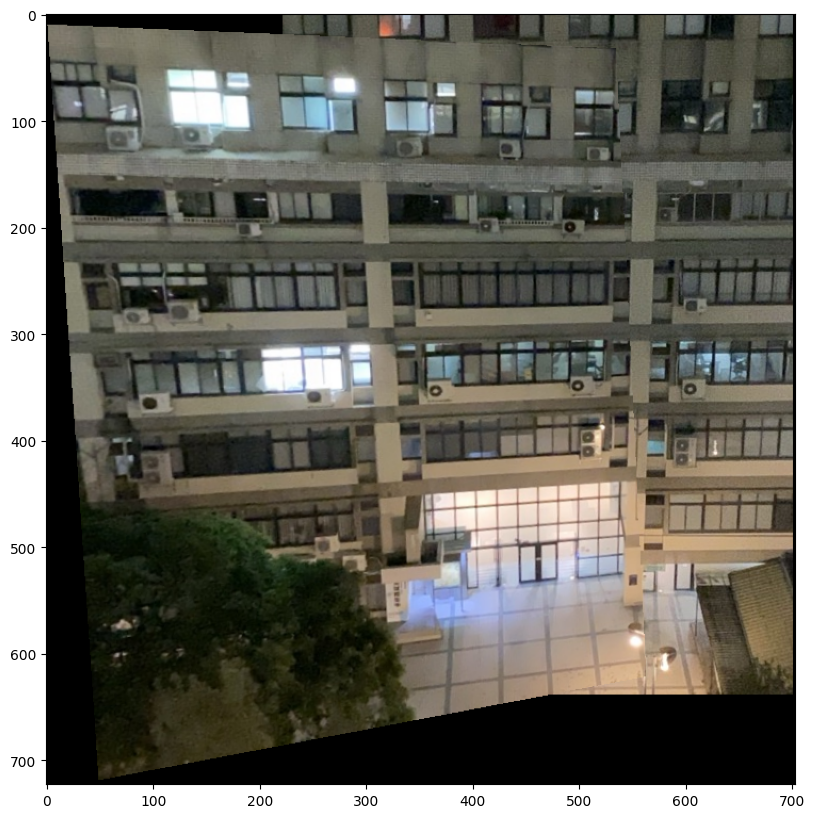

In [24]:
plt.figure(figsize=(20,10))
plt.imshow(destination)

In [26]:
def stitch_images(A_img,B_img):
    #fig, ax = plt.subplots(1,3, figsize=(20,10))
    
    print(A_img.shape)
    print(B_img.shape)
    A_img_bw = cv2.cvtColor(A_img, cv2.COLOR_BGR2GRAY)
    B_img_bw = cv2.cvtColor(B_img, cv2.COLOR_BGR2GRAY)

    A_img_color = A_img
    B_img_color = B_img

    print('find matches')
    A_keypoints, B_keypoints = get_img_matches(A_img_bw, B_img_bw)
    print(f"found {A_keypoints.shape[0]} matches")

    print('find ransac homo')
    H_b2a, ratio = ransac_find_homograpy(
        A_keypoints, B_keypoints,
        treshold = 10,
        num_iterations = 400,
        N = 5
    )
    print('ratio of points in treshold',ratio)

    # x*_A_y* means in A coord space
    _, A_a_bb = get_border_and_bb(A_img_bw, np.eye(3))
    _, B_a_bb = get_border_and_bb(B_img_bw, H_b2a)
    
    width_d, height_d, T_a2d, bb_list_d = determine_dest_img_dimensions_and_transform([A_a_bb, B_a_bb])
    A_d_bb, B_d_bb = bb_list_d

    destination = np.zeros((height_d, width_d, 3), dtype=np.uint8)

    print('warp 1')
    warp_fast(destination, A_img_color, A_d_bb, T_a2d)
    # ax[0].imshow(destination)
    
    print('warp 2')
    warp_fast(destination, B_img_color ,B_d_bb, np.matmul(T_a2d,H_b2a))
    # ax[1].imshow(destination)

    return destination
    

#res_a = stitch_images(cv2.imread("custom_data/07/1.jpeg"), cv2.imread("custom_data/07/2.jpeg"))
#plt.imshow(res_a)


loaded 5 images
(1280, 1280, 3)
(1280, 1280, 3)
find matches
searching for SIFT keypoints
matching keypoints
found 1036 matches
find ransac homo
ratio of points in treshold 0.9942084942084942
warp 1
warp 2
stitch 0
(1555, 1518, 3)
(1280, 1280, 3)
find matches
searching for SIFT keypoints
matching keypoints
found 542 matches
find ransac homo
ratio of points in treshold 0.985239852398524
warp 1
warp 2
stitch 1
(2023, 1890, 3)
(1280, 1280, 3)
find matches
searching for SIFT keypoints
matching keypoints
found 271 matches
find ransac homo
ratio of points in treshold 0.9630996309963099
warp 1
warp 2
stitch 2
(2741, 2357, 3)
(1280, 1280, 3)
find matches
searching for SIFT keypoints
matching keypoints
found 286 matches
find ransac homo
ratio of points in treshold 0.9195804195804196
warp 1
warp 2
stitch 3


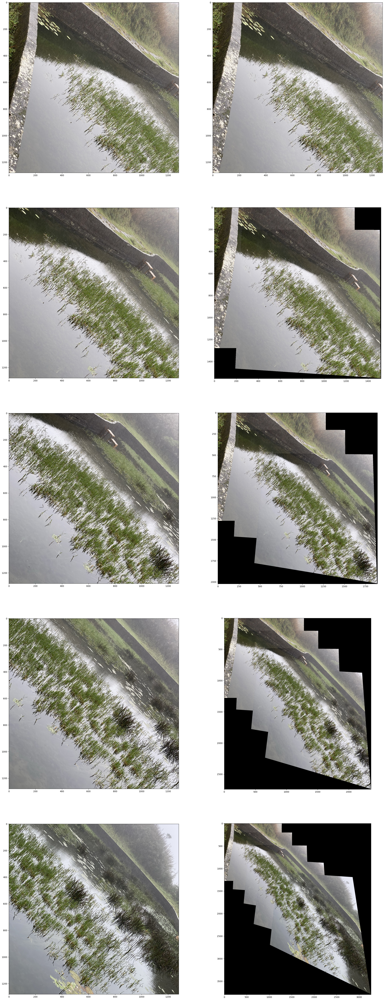

In [42]:
def stitch_in_folder(path):
    image_paths = sorted(glob.glob(f'custom_data/{path}/*.jpeg'))

    images = [cv2.imread(image_path) for image_path in image_paths]
    images = [cv2.cvtColor(image, cv2.COLOR_BGR2RGB) for image in images]

    fig, axes = plt.subplots(nrows=len(images),ncols=2, figsize = (30,80))
    print(f"loaded {len(images)} images")
        
    res = images[0]

    axes[0, 0].imshow(res)
    axes[0, 1].imshow(res)
    
    for i in range(0, len(images) - 1):
        try:
            res = stitch_images(res,images[i+1])
            axes[i + 1,0].imshow(images[i+1])
            axes[i + 1,1].imshow(res)
            print(f"stitch {i}")
        except:
            return res

    return res

res = stitch_in_folder("26")

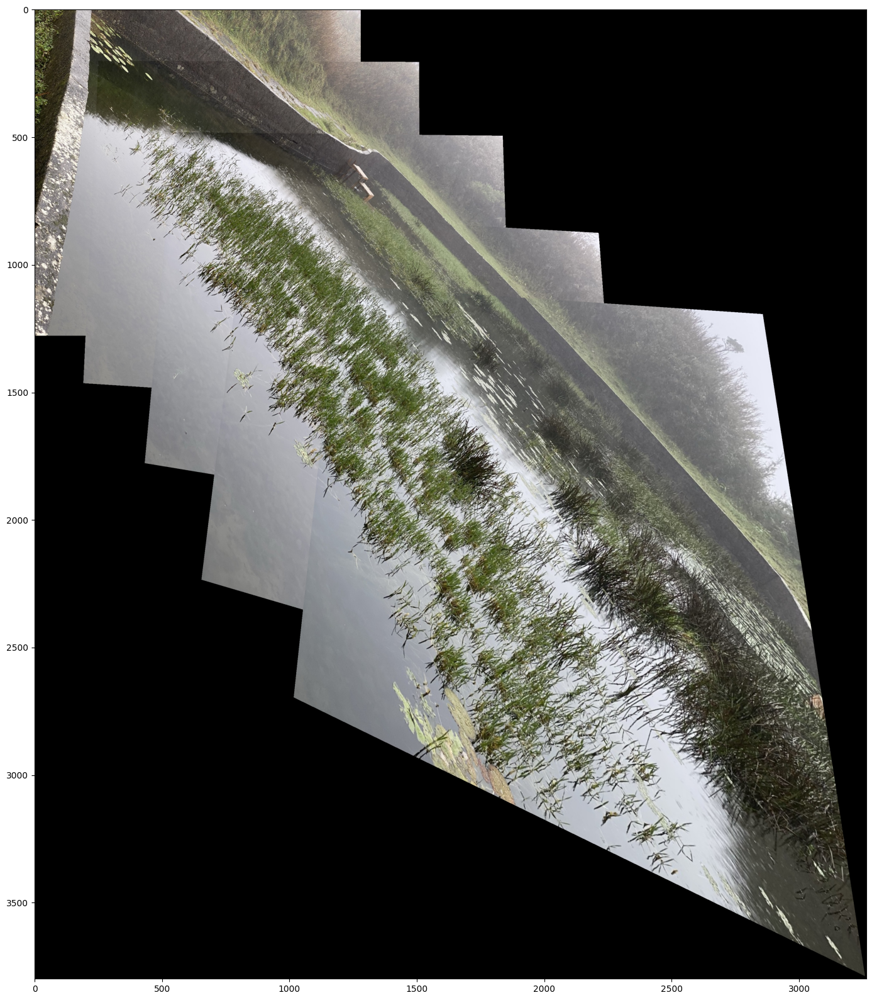

In [43]:
plt.figure(figsize=(20,20))
plt.imshow(res)

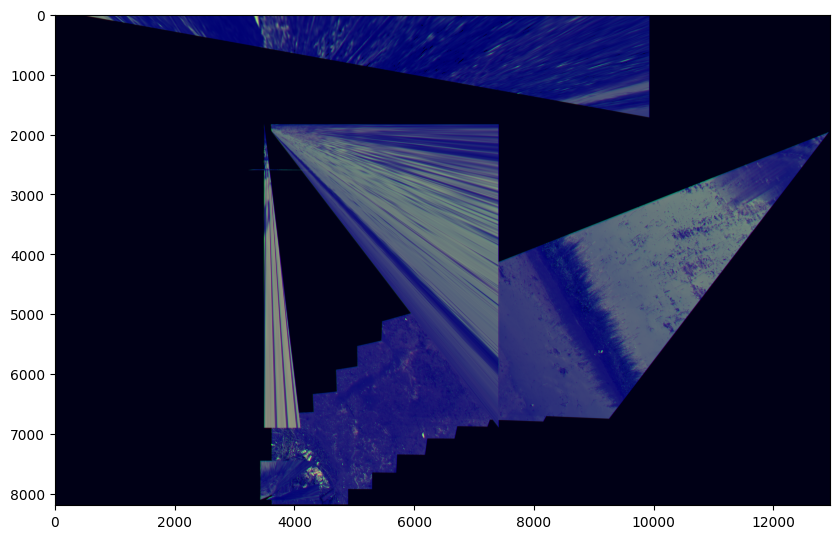

In [38]:
from scipy.ndimage import gaussian_filter
#res = cv2.cvtColor(res, cv2.COLOR_RGB2BGR)
plt.figure(figsize=(10,10))

adj = res.astype(np.float64) / 255

adj[:,:, 0] = np.roll(adj[:,:,0], 10, axis=0)
adj[:,:, 0] = np.roll(adj[:,:,0], 10, axis=1)

adj[:,:, 2] = np.roll(adj[:,:,2], 10, axis=1)
adj[:,:,2] = np.pow(adj[:,:,2], 0.01) - 0.3
adj[:,:,0] = gaussian_filter(adj[:,:,0], sigma=10)

plt.imshow(np.pow(adj, 2))